# Prerequisites

- Python 3.10.4

> Warning: Installation from conda environment may take few minutes

Configuring conda environment
```cmd
conda create -n ca2_env
conda activate ca2_env
conda install -c plotly plotly_express
conda install -c anaconda seaborn
conda install -c conda-forge geojson
```

Installing jupyter notebook on ca2_env environment
```cmd
conda install jupyter notebook
python -m ipykernel install --name ca2_env
```

Run jupiter 
```cmd
jupyter notebook
```

In [1]:
from preamble import agriculture
import pandas as pd
import plotly.express as px
import seaborn as sns

# Economic Accounts in Agriculture DataSets
- Labour productivity
  - aact_eaa06: Economic accounts for agriculture - agricultural income (indicators A, B, C)
  - aact_eaa05: Economic accounts for agriculture - indices: volume, price, values
  - aact_ali02: Agricultural labour input statistics: indices
  

## Labour productivity
### aact_eaa06: Economic accounts for agriculture - agricultural income (indicators A, B, C)

In [2]:
aact_eaa06_df = pd.read_csv("../data/eurostat/economic_accounts/aact_eaa06_linear.csv")

In [3]:
aact_eaa06_df.head(5)

,DATAFLOW,LAST UPDATE,freq,itm_newa,unit,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG
0,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1990,81.95,NaN
1,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1991,81.44,NaN
2,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1992,76.18,NaN
3,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1993,72.65,NaN
4,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1994,83.92,NaN


In [4]:
aact_eaa06_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8458 entries, 0 to 8457
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DATAFLOW     8458 non-null   object 
 1   LAST UPDATE  8458 non-null   object 
 2   freq         8458 non-null   object 
 3   itm_newa     8458 non-null   object 
 4   unit         8458 non-null   object 
 5   geo          8458 non-null   object 
 6   TIME_PERIOD  8458 non-null   int64  
 7   OBS_VALUE    8458 non-null   float64
 8   OBS_FLAG     216 non-null    object 
dtypes: float64(1), int64(1), object(7)
memory usage: 594.8+ KB


In [5]:
aact_eaa06_df.describe()

,TIME_PERIOD,OBS_VALUE
count,8458.000000,8458.000000
mean,2005.727477,187.909479
std,9.873103,3566.378914
min,1974.000000,0.000000
25%,2001.000000,91.142500
50%,2007.000000,102.370000
75%,2013.000000,118.197500
max,2021.000000,233548.900000


In [6]:
aact_eaa06_df.isnull().sum()

DATAFLOW          0
LAST UPDATE       0
freq              0
itm_newa          0
unit              0
geo               0
TIME_PERIOD       0
OBS_VALUE         0
OBS_FLAG       8242
dtype: int64

In [7]:
aact_eaa06_df.itm_newa.unique()
# IND_A_EURO	Indicator A: Index of the real income of factors in agriculture per annual work unit
# IND_B_EURO	Indicator B: Index of real net agricultural entrepreneurial income, per unpaid annual work unit
# IND_C_EURO	Indicator C: Net entrepreneurial income of agriculture


array(['IND_A_EURO', 'IND_B_EURO', 'IND_C_EURO'], dtype=object)

  
  ### aact_eaa05: Economic accounts for agriculture - indices: volume, price, values

In [8]:
aact_eaa05_df = pd.read_csv("../data/eurostat/economic_accounts/aact_eaa05_linear.csv")

In [9]:
aact_eaa05_df.shape

(3646543, 11)

In [10]:
aact_eaa05_df.head(5)

,DATAFLOW,LAST UPDATE,freq,itm_newa,indic_ag,p_adj,unit,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG
0,ESTAT:AACT_EAA05(1.0),14/03/22 11:00:00,A,1000,PROD_BP,NP,I05,AT,1990,257.75,NaN
1,ESTAT:AACT_EAA05(1.0),14/03/22 11:00:00,A,1000,PROD_BP,NP,I05,AT,1991,249.91,NaN
2,ESTAT:AACT_EAA05(1.0),14/03/22 11:00:00,A,1000,PROD_BP,NP,I05,AT,1992,242.05,NaN
3,ESTAT:AACT_EAA05(1.0),14/03/22 11:00:00,A,1000,PROD_BP,NP,I05,AT,1993,243.46,NaN
4,ESTAT:AACT_EAA05(1.0),14/03/22 11:00:00,A,1000,PROD_BP,NP,I05,AT,1994,242.91,NaN


In [11]:
aact_eaa05_df.indic_ag.unique()
# PROD_BP	Production value at basic price
# PROD_PP	Production value at producer price
# SUBS	Subsidies on products
# TAX	Taxes on products

array(['PROD_BP', 'PROD_PP', 'SUBS', 'TAX'], dtype=object)

In [12]:
aact_eaa05_df.isnull().sum()

DATAFLOW             0
LAST UPDATE          0
freq                 0
itm_newa             0
indic_ag             0
p_adj                0
unit                 0
geo                  0
TIME_PERIOD          0
OBS_VALUE        11110
OBS_FLAG       3570773
dtype: int64

  
  ### aact_ali02: Agricultural labour input statistics: indices

In [13]:
aact_ali02_df = pd.read_csv("../data/eurostat/agricultural_income/aact_ali02_linear.csv")

In [14]:
aact_ali02_df.head()

,DATAFLOW,LAST UPDATE,freq,unit,itm_newa,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG
0,ESTAT:AACT_ALI02(1.0),14/03/22 11:00:00,A,I05,40000,AT,1990,155.76,NaN
1,ESTAT:AACT_ALI02(1.0),14/03/22 11:00:00,A,I05,40000,AT,1991,156.25,NaN
2,ESTAT:AACT_ALI02(1.0),14/03/22 11:00:00,A,I05,40000,AT,1992,148.91,NaN
3,ESTAT:AACT_ALI02(1.0),14/03/22 11:00:00,A,I05,40000,AT,1993,142.44,NaN
4,ESTAT:AACT_ALI02(1.0),14/03/22 11:00:00,A,I05,40000,AT,1994,136.18,NaN


In [15]:
aact_ali02_df.itm_newa.unique()
# 40000	Total labour force input
# 41000	Non-salaried
# 42000	Salaried

array([40000, 41000, 42000], dtype=int64)

## Ireland

In [16]:
# 40000	Total labour force input
ie_labour_force_df = aact_ali02_df.query("geo=='IE' and itm_newa==40000")

# PROD_PP	Production value at producer price
ie_procution_value_producer_price_df = aact_eaa05_df.query("geo=='IE' and indic_ag=='PROD_PP'")

# IND_A_EURO	Indicator A: Index of the real income of factors in agriculture per annual work unit
ie_indicator_a_df = aact_eaa06_df.query("geo=='IE' and itm_newa=='IND_A_EURO'")


In [17]:
ie_labour_force_df.shape, ie_procution_value_producer_price_df.shape, ie_indicator_a_df.shape

((64, 9), (20259, 11), (77, 9))

### Visualize Production value at producer price

In [18]:
prod_pp_codelist_pd = pd.read_csv("../data/eurostat/economic_accounts/aact_eaa05_codelists/ESTAT_ITM_NEWA_en.tsv", 
                                  sep='\t',names=["code","code_name"])

In [19]:
prod_pp_codelist_pd["description"] =  '(' + prod_pp_codelist_pd.code + ') ' + prod_pp_codelist_pd.code_name

In [20]:
# convert itm_newa to string 1000 -> 01000
ie_procution_value_producer_price_df["itm_newa"] = ie_procution_value_producer_price_df.itm_newa.apply(lambda x: f'{x:05d}')

C:\Users\rmsry\AppData\Local\Temp\ipykernel_19744\882987090.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ie_procution_value_producer_price_df["itm_newa"] = ie_procution_value_producer_price_df.itm_newa.apply(lambda x: f'{x:05d}')


In [21]:
ie_procution_value_producer_price_df = ie_procution_value_producer_price_df.merge(
    prod_pp_codelist_pd,
    left_on="itm_newa",
    right_on="code",
    how="inner")

In [22]:
ie_eaa_df = ie_procution_value_producer_price_df[["code","description","p_adj","unit", "freq", "TIME_PERIOD","OBS_VALUE"]]
ie_eaa_df.columns = ["code","description","price_adj","unit","frequence","year","value"]

In [23]:
ie_eaa_df.groupby("unit").size()

unit
I05      6830
I10      6297
I_N_1    7132
dtype: int64

<AxesSubplot:xlabel='year', ylabel='value'>

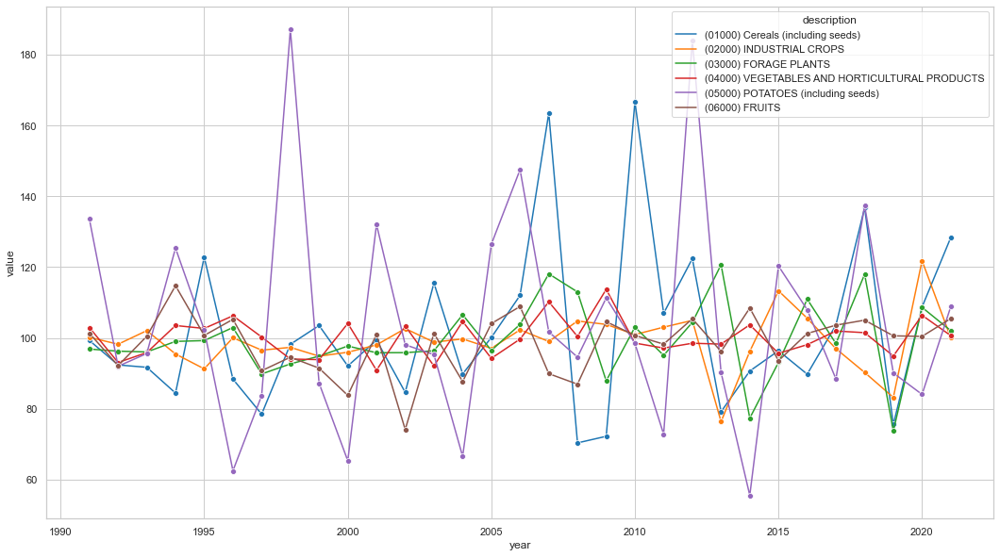

In [24]:
from matplotlib import pyplot as plt
sns.set_theme(style="whitegrid")
plt.figure(figsize=(18,10))
filter_items = ["01000","02000","03000","04000","05000","06000"]
sns.lineplot(data=ie_eaa_df.query("unit == 'I_N_1' and price_adj=='RP' and code in @filter_items"),
            palette="tab10", 
            hue="description", 
            x="year", 
            y="value",
            marker="o")

# Interactive Dashboards
## Indicator A

In [25]:
import plotly.graph_objects as go

In [26]:
country_codes = pd.read_csv("../data/country_codes.tsv", sep='\t')
country_codes.head()

,Country,Alpha-2 code,Alpha-3 code,Numeric
0,Afghanistan,AF,AFG,4
1,Albania,AL,ALB,8
2,Algeria,DZ,DZA,12
3,American Samoa,AS,ASM,16
4,Andorra,AD,AND,20


In [27]:
incidator_a_df = aact_eaa06_df.query("itm_newa=='IND_A_EURO'")
incidator_a_df = incidator_a_df.merge(country_codes,left_on="geo", right_on="Alpha-2 code", how="inner")

In [28]:
import geojson
from urllib.request import urlopen
import json

    
# https://github.com/eurostat/Nuts2json
# https://raw.githubusercontent.com/eurostat/Nuts2json/master/2021/4326/20M/nutsbn_0.json
# Europe GeoJson Administrative units
# Opening JSON file

with urlopen('https://raw.githubusercontent.com/eurostat/Nuts2json/master/2021/4326/20M/nutsrg_0.json') as response:
    countries = json.load(response)


In [29]:
 import plotly.graph_objects as go
 import json
 import urllib.request
 import random

 def read_geojson(url):
     with urllib.request.urlopen(url) as url:
         jdata = json.loads(url.read().decode())
     return jdata 

irish_url = 'https://gist.githubusercontent.com/pnewall/9a122c05ba2865c3a58f15008548fbbd/raw/5bb4f84d918b871ee0e8b99f60dde976bb711d7c/ireland_counties.geojson'

jdata = read_geojson(irish_url)

thelist = jdata['features']
locations =  [item['id'] for item in thelist ]

randomlist = []
for i in range(0,26):
    n = random.randint(0,10)
    randomlist.append(n)

z = randomlist

print('z: ', z)
mapboxt = open("..\data\mapbox_token.txt").read().rstrip() #my mapbox_access_token  must be used only for special mapbox style
print('mapboxt: ', mapboxt)

fig= go.Figure(go.Choroplethmapbox(z=z, # This is the data.
                            locations=locations,
                            colorscale='reds',
                            colorbar=dict(thickness=20, ticklen=3),
                            geojson=jdata,
                            text=locations,
                            hoverinfo='all',
                            marker_line_width=1, marker_opacity=0.75))
                            
                            
fig.update_layout(title_text= 'Symptom Map',
                  title_x=0.5, width = 700,height=700,
                  mapbox = dict(center= dict(lat=53.425049,  lon=-7.944620),
                                 accesstoken= mapboxt,
                                 style='basic',
                                 zoom=5.6,
                               ));
fig.show()

z:  [3, 2, 7, 3, 9, 8, 7, 10, 10, 1, 3, 3, 4, 2, 10, 4, 5, 0, 4, 6, 3, 8, 6, 7, 4, 6]
mapboxt:  pk.eyJ1Ijoicm1zcnl1IiwiYSI6ImNsMmphaG96ajB2eGQzaXRwamxtMmxmN2MifQ.sclOQTUiqWu1_lwaky0xRw


In [30]:
incidator_a_df

,DATAFLOW,LAST UPDATE,freq,itm_newa,unit,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG,Country,Alpha-2 code,Alpha-3 code,Numeric
0,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1990,81.95,NaN,Austria,AT,AUT,40
1,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1991,81.44,NaN,Austria,AT,AUT,40
2,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1992,76.18,NaN,Austria,AT,AUT,40
3,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1993,72.65,NaN,Austria,AT,AUT,40
4,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I05,AT,1994,83.92,NaN,Austria,AT,AUT,40
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2152,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,IS,2017,96.71,NaN,Iceland,IS,ISL,352
2153,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,IS,2018,81.50,NaN,Iceland,IS,ISL,352
2154,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,IS,2019,94.50,NaN,Iceland,IS,ISL,352
2155,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,IS,2020,115.81,NaN,Iceland,IS,ISL,352


In [31]:
fig = go.Figure([
    go.Choropleth(
        geojson = countries,
        locations = incidator_a_df["geo"],
        z = incidator_a_df["OBS_VALUE"],
        text = incidator_a_df["Country"]
)])
fig.update_geos(
    fitbounds="locations",
    resolution=50,
    visible=False,
    showframe=False,
    projection={"type": "mercator"},
)

In [32]:
#fig = px.choropleth(incidator_a_df,
#                    geojson=geojson,
#                    locations="Alpha-3 code", # colunm containing ISO 3166 country codes
#                    color="OBS_VALUE",  # column by which to color-code
#                    hover_name="Country", # column to display in hover information
#                    color_continuous_scale=px.colors.sequential.Plasma)
#fig.show()

In [33]:
incidator_a_df.query("TIME_PERIOD == 2021 and itm_newa == 'IND_A_EURO' and unit == 'I_N_1'")

,DATAFLOW,LAST UPDATE,freq,itm_newa,unit,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG,Country,Alpha-2 code,Alpha-3 code,Numeric
75,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,AT,2021,103.28,e,Austria,AT,AUT,40
172,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,BE,2021,90.80,e,Belgium,BE,BEL,56
229,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,BG,2021,132.89,e,Bulgaria,BG,BGR,100
316,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,CH,2021,93.63,e,Switzerland,CH,CHE,756
375,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,CY,2021,98.32,e,Cyprus,CY,CYP,196
436,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,CZ,2021,101.88,e,Czechia,CZ,CZE,203
511,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,DE,2021,89.19,e,Germany,DE,DEU,276
618,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,DK,2021,66.44,e,Denmark,DK,DNK,208
685,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,EE,2021,99.79,e,Estonia,EE,EST,233
762,ESTAT:AACT_EAA06(1.0),14/03/22 11:00:00,A,IND_A_EURO,I_N_1,ES,2021,94.80,e,Spain,ES,ESP,724


In [34]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/eurostat/Nuts2json/master/2021/4326/20M/nutsrg_0.json') as response:
    counties = json.load(response)

counties["features"][0]



{'type': 'Feature',
 'properties': {'id': 'FR', 'na': 'France'},
 'geometry': {'type': 'MultiPolygon',
  'coordinates': [[[[2.54675233761688, 51.08952947647383],
     [2.57892894644732, 51.00051502575129],
     [2.607530376518824, 50.91357067853393],
     [2.6468573428671434, 50.82455622781139],
     [2.8649432471623584, 50.70863043152158],
     [3.0186759337966897, 50.77280364018201],
     [3.0973298664933253, 50.77901395069753],
     [3.1759837991899573, 50.75624281214061],
     [3.2439121956097807, 50.71277063853193],
     [3.3118405920296006, 50.52232111605581],
     [3.5478023901195037, 50.4974798739937],
     [3.615730786539327, 50.49126956347818],
     [3.655057752887643, 50.46228811440572],
     [3.672933646682335, 50.39811490574529],
     [3.7158357917895906, 50.327731386569326],
     [4.0268763438171895, 50.35878293914696],
     [4.051902595129757, 50.338081904095205],
     [4.184184209210461, 50.23664683234162],
     [4.2056352817640885, 50.0793189659483],
     [4.1412820641

In [35]:
df = incidator_a_df.query("itm_newa == 'IND_A_EURO' and unit == 'I_N_1'")
df = df.sort_values(by=['geo', 'TIME_PERIOD'])

In [36]:
df.geo.unique()

array(['AT', 'BE', 'BG', 'CH', 'CY', 'CZ', 'DE', 'DK', 'EE', 'ES', 'FI',
       'FR', 'HR', 'HU', 'IE', 'IS', 'IT', 'LT', 'LU', 'LV', 'MT', 'NL',
       'NO', 'PL', 'PT', 'RO', 'SE', 'SI', 'SK'], dtype=object)

In [39]:
#df.query("geo == 'IE'").TIME_PERIOD.sort_values().unique()

In [38]:
fig = px.choropleth_mapbox(df.query("TIME_PERIOD > 1991"),
                           geojson=counties,
                           locations='geo',
                           featureidkey="properties.id",
                           animation_frame="TIME_PERIOD",
                           color='OBS_VALUE',
                           color_continuous_scale="Viridis",
                           range_color=(df.OBS_VALUE.min(), df.OBS_VALUE.max()),
                           mapbox_style="carto-positron",
                           zoom=3,
                           center = {"lat": 48.289228872600525, "lon": 10.897123483023739},
                           opacity=0.5,
                           labels={'OBS_VALUE':'Value'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()